In [1]:
import sys
print(sys.path)
sys.path.append('E:\\学习\\6科研\\论文\\博士论文\\stAggregator\\stAggregator\\')

['E:\\学习\\6科研\\论文\\博士论文\\stAggregator\\stAggregator\\analysis\\0DLPFC', 'C:\\Users\\10360\\anaconda3\\envs\\py39\\python39.zip', 'C:\\Users\\10360\\anaconda3\\envs\\py39\\DLLs', 'C:\\Users\\10360\\anaconda3\\envs\\py39\\lib', 'C:\\Users\\10360\\anaconda3\\envs\\py39', '', 'C:\\Users\\10360\\AppData\\Roaming\\Python\\Python39\\site-packages', 'C:\\Users\\10360\\anaconda3\\envs\\py39\\lib\\site-packages', 'C:\\Users\\10360\\anaconda3\\envs\\py39\\lib\\site-packages\\win32', 'C:\\Users\\10360\\anaconda3\\envs\\py39\\lib\\site-packages\\win32\\lib', 'C:\\Users\\10360\\anaconda3\\envs\\py39\\lib\\site-packages\\Pythonwin']


In [2]:
import scanpy as sc
import pandas as pd
import numpy as np
import torch
import dgl
import random
from scipy.sparse import csr_matrix
from sklearn.metrics import adjusted_rand_score as ari_score
from sklearn.metrics.cluster import normalized_mutual_info_score

In [3]:
from stAggregator import stAggregator
from stAggregator import metrics
from stAggregator.data import process_adata, process_graph, mclust_R_smooth
from stAggregator.data import process_graph

In [4]:
seed = 42
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)
dgl.random.seed(seed)

In [5]:
def refine_label(adata, radius=50, key='label'):
    import ot
    n_neigh = radius
    new_type = []
    old_type = adata.obs[key].values

    # calculate distance
    position = adata.obsm['spatial']
    distance = ot.dist(position, position, metric='euclidean')

    n_cell = distance.shape[0]

    for i in range(n_cell):
        vec = distance[i, :]
        index = vec.argsort()
        neigh_type = []
        for j in range(1, n_neigh + 1):
            neigh_type.append(old_type[index[j]])
        max_type = max(neigh_type, key=neigh_type.count)
        new_type.append(max_type)

    new_type = [str(i) for i in list(new_type)]

    return new_type

In [6]:
def mclust_R(adata, num_cluster, modelNames='EEE', used_obsm='emb_pca', random_seed=42):
    """\
    Clustering using the mclust algorithm.
    The parameters are the same as those in the R package mclust.
    """

    np.random.seed(random_seed)
    import rpy2.robjects as robjects
    robjects.r.library("mclust")

    import rpy2.robjects.numpy2ri
    rpy2.robjects.numpy2ri.activate()
    r_random_seed = robjects.r['set.seed']
    r_random_seed(random_seed)
    rmclust = robjects.r['Mclust']

    res = rmclust(rpy2.robjects.numpy2ri.numpy2rpy(adata.obsm[used_obsm]), num_cluster, modelNames)
    mclust_res = np.array(res[-2])

    adata.obs['mclust'] = mclust_res
    adata.obs['mclust'] = adata.obs['mclust'].astype('int')
    adata.obs['mclust'] = adata.obs['mclust'].astype('category')
    adata.obsm['mclust_prob'] = np.array(res[-3])
    return adata

In [7]:
def mclust_R_smooth(adata, num_cluster, modelNames='EEE', used_obsm='X_pca', radius=50, random_seed=42):
    """\
    Clustering using the mclust algorithm.
    The parameters are the same as those in the R package mclust.
    """

    np.random.seed(random_seed)
    import rpy2.robjects as robjects
    robjects.r.library("mclust")

    import rpy2.robjects.numpy2ri
    rpy2.robjects.numpy2ri.activate()
    r_random_seed = robjects.r['set.seed']
    r_random_seed(random_seed)
    rmclust = robjects.r['Mclust']

    res = rmclust(rpy2.robjects.numpy2ri.numpy2rpy(adata.obsm[used_obsm]), num_cluster, modelNames)
    mclust_res = np.array(res[-2])

    adata.obs['mclust'] = mclust_res
    adata.obs['mclust'] = adata.obs['mclust'].astype('int')
    adata.obs['mclust'] = adata.obs['mclust'].astype('category')
    adata.obsm['mclust_prob'] = np.array(res[-3])

    adata.obs['mclust'] = refine_label(adata, radius=radius, key='mclust')

    return adata

In [8]:
from stAggregator.metrics import evaluate_all

In [9]:
sc.set_figure_params(dpi=300, figsize=(4, 4), frameon=False)    # TODO 是否画边框

In [10]:
def clear_fig(fig):
    if fig:
        fig.axes[0].set_xlabel(None)
        fig.axes[0].set_ylabel(None)
        fig.tight_layout()
    else:
        pass
    return fig

## train

151507
------Calculating spatial graph...
The graph contains 24770 edges, 4226 cells.
5.8613 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:20<00:00, 19.33it/s, recon_loss_mse=507.413, sl1_loss=1.402, sl2_loss=1.365, lr: 0.001]
2024-06-24 09:02:32,108 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:02:33,280 - rpy2.situation - INFO - cffi mode is CFFI_MODE.ANY
2024-06-24 09:02:33,286 - rpy2.situation - INFO - R home found: C:\Program Files\R\R-4.2.1
2024-06-24 09:02:33,298 - rpy2.rinterface_lib.embedded - INFO - Default options to initialize R: rpy2, --quiet, --no-save
2024-06-24 09:02:33,747 - rpy2.rinterface_lib.callbacks - WARNING - R[write to console]:                    __           __ 
   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.0.0
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.609
mclust, NMI = 0.715


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151508
------Calculating spatial graph...
The graph contains 25698 edges, 4384 cells.
5.8618 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:15<00:00, 25.30it/s, recon_loss_mse=549.003, sl1_loss=1.371, sl2_loss=1.387, lr: 0.001]
2024-06-24 09:03:40,254 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:03:40,254 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.605
mclust, NMI = 0.682


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151509
------Calculating spatial graph...
The graph contains 28172 edges, 4789 cells.
5.8826 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:17<00:00, 23.30it/s, recon_loss_mse=528.983, sl1_loss=1.360, sl2_loss=1.353, lr: 0.001]
2024-06-24 09:04:43,272 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:04:43,272 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:04:43,272 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.401
mclust, NMI = 0.588


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151510
------Calculating spatial graph...
The graph contains 27198 edges, 4634 cells.
5.8692 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:16<00:00, 24.71it/s, recon_loss_mse=503.369, sl1_loss=1.336, sl2_loss=1.342, lr: 0.001]
2024-06-24 09:05:47,275 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:05:47,275 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:05:47,275 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:05:47,275 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.569
mclust, NMI = 0.638


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151673
------Calculating spatial graph...
The graph contains 21124 edges, 3639 cells.
5.8049 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:14<00:00, 27.31it/s, recon_loss_mse=451.457, sl1_loss=1.253, sl2_loss=1.267, lr: 0.001]
2024-06-24 09:06:49,573 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:06:49,573 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:06:49,573 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:06:49,573 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:06:49,573 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.661
mclust, NMI = 0.735


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151674
------Calculating spatial graph...
The graph contains 21258 edges, 3673 cells.
5.7876 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:14<00:00, 26.92it/s, recon_loss_mse=401.268, sl1_loss=1.340, sl2_loss=1.306, lr: 0.001]
2024-06-24 09:07:51,606 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:07:51,606 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:07:51,606 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:07:51,606 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:07:51,606 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:07:51,606 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.639
mclust, NMI = 0.747


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151675
------Calculating spatial graph...
The graph contains 20762 edges, 3592 cells.
5.7801 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:14<00:00, 27.38it/s, recon_loss_mse=501.762, sl1_loss=1.301, sl2_loss=1.318, lr: 0.001]
2024-06-24 09:08:51,085 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:08:51,085 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:08:51,085 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:08:51,085 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:08:51,085 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:08:51,085 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:08:51,085 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.612
mclust, NMI = 0.695


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151676
------Calculating spatial graph...
The graph contains 20052 edges, 3460 cells.
5.7954 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:14<00:00, 27.26it/s, recon_loss_mse=485.129, sl1_loss=1.323, sl2_loss=1.323, lr: 0.001]
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:09:48,302 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.572
mclust, NMI = 0.690


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151669
------Calculating spatial graph...
The graph contains 21194 edges, 3661 cells.
5.7891 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:14<00:00, 27.02it/s, recon_loss_mse=450.287, sl1_loss=1.374, sl2_loss=1.404, lr: 0.001]
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:10:45,307 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.460
mclust, NMI = 0.620


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151670
------Calculating spatial graph...
The graph contains 20370 edges, 3498 cells.
5.8233 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:14<00:00, 27.54it/s, recon_loss_mse=473.966, sl1_loss=1.382, sl2_loss=1.390, lr: 0.001]
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:11:40,337 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.561
mclust, NMI = 0.597


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151671
------Calculating spatial graph...
The graph contains 24052 edges, 4110 cells.
5.8521 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:16<00:00, 25.00it/s, recon_loss_mse=436.022, sl1_loss=1.411, sl2_loss=1.375, lr: 0.001]
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:12:36,922 - root - INFO - Output dir: ./log/integration/
2024-06-24 0

fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.634
mclust, NMI = 0.735


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

151672
------Calculating spatial graph...
The graph contains 23382 edges, 4015 cells.
5.8237 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:15<00:00, 25.28it/s, recon_loss_mse=467.815, sl1_loss=1.375, sl2_loss=1.375, lr: 0.001]
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 09:13:36,763 - root - INFO - Output dir: ./log/integration/
2024-06-24 0

fitting ...
  |======================================================================| 100%


... storing 'mclust' as categorical


mclust, ARI = 0.578
mclust, NMI = 0.703


  0%|          | 0/100 [00:00<?, ?/s]

  0%|          | 0/100 [00:00<?, ?/s]

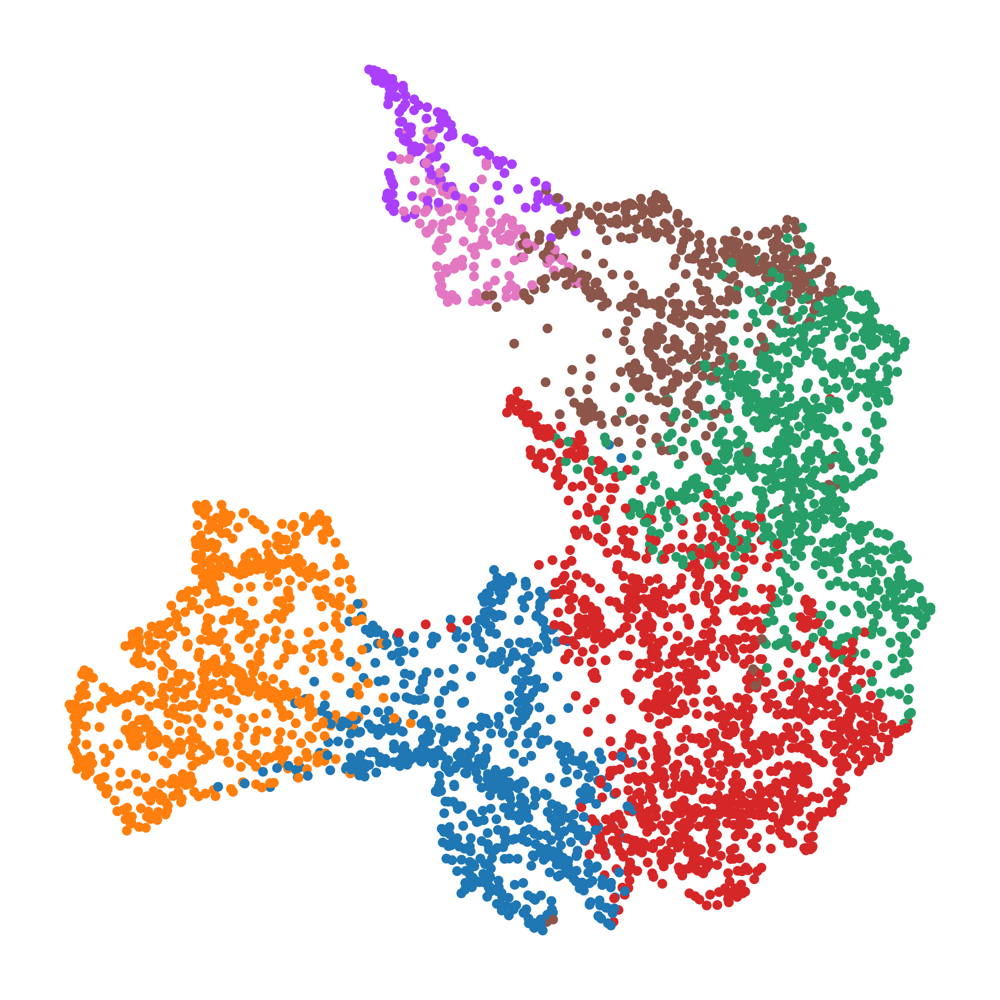

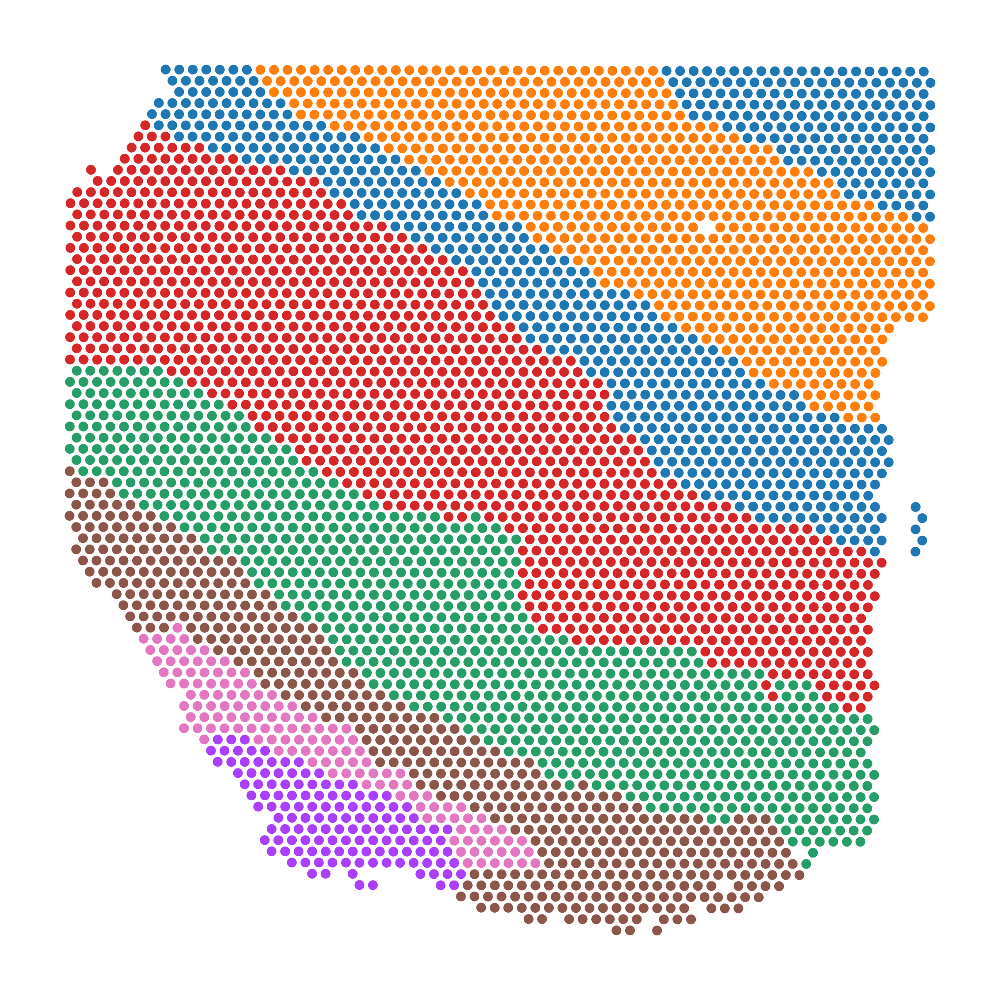

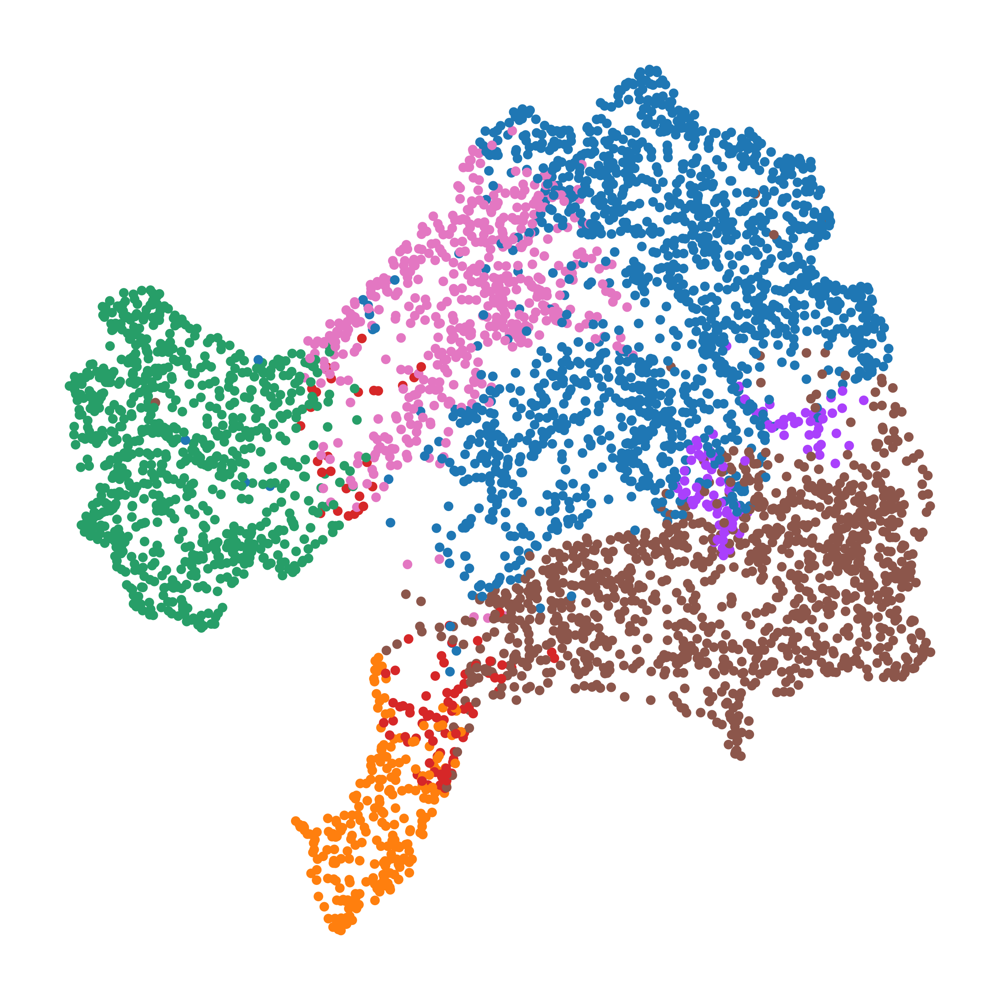

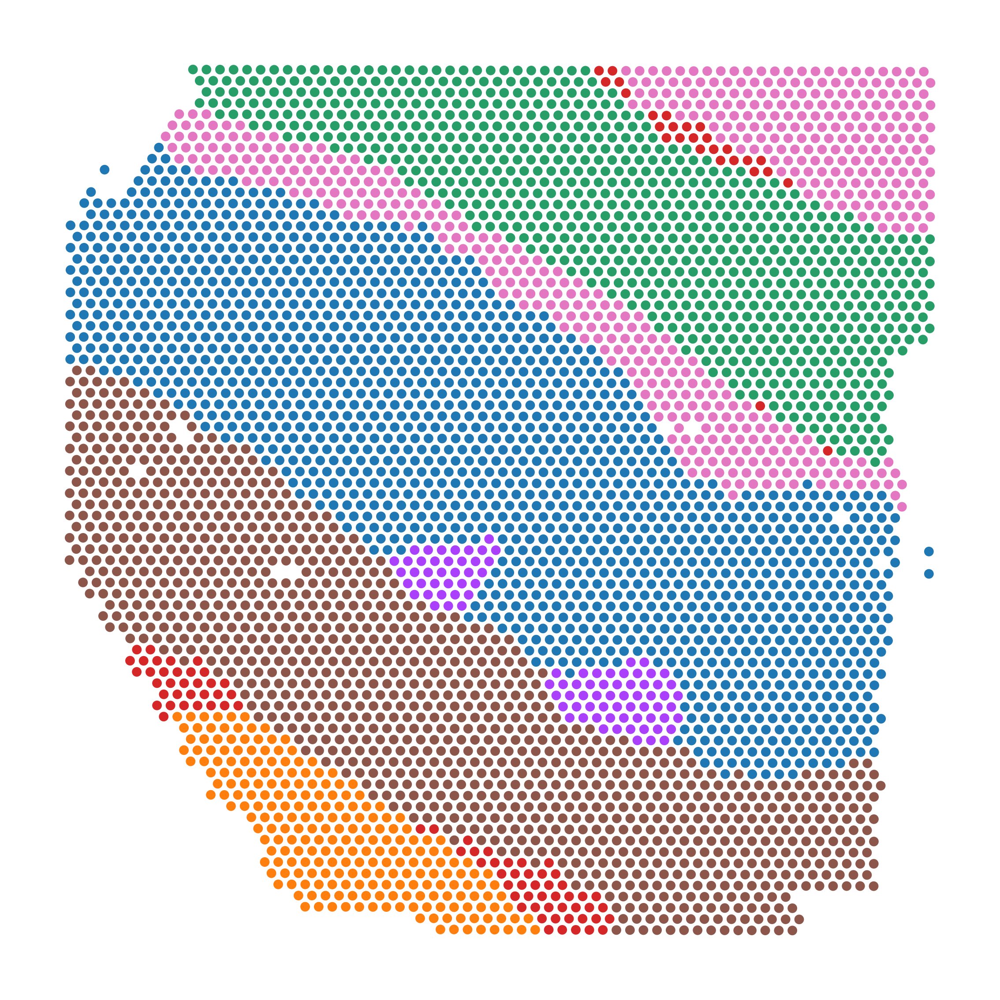

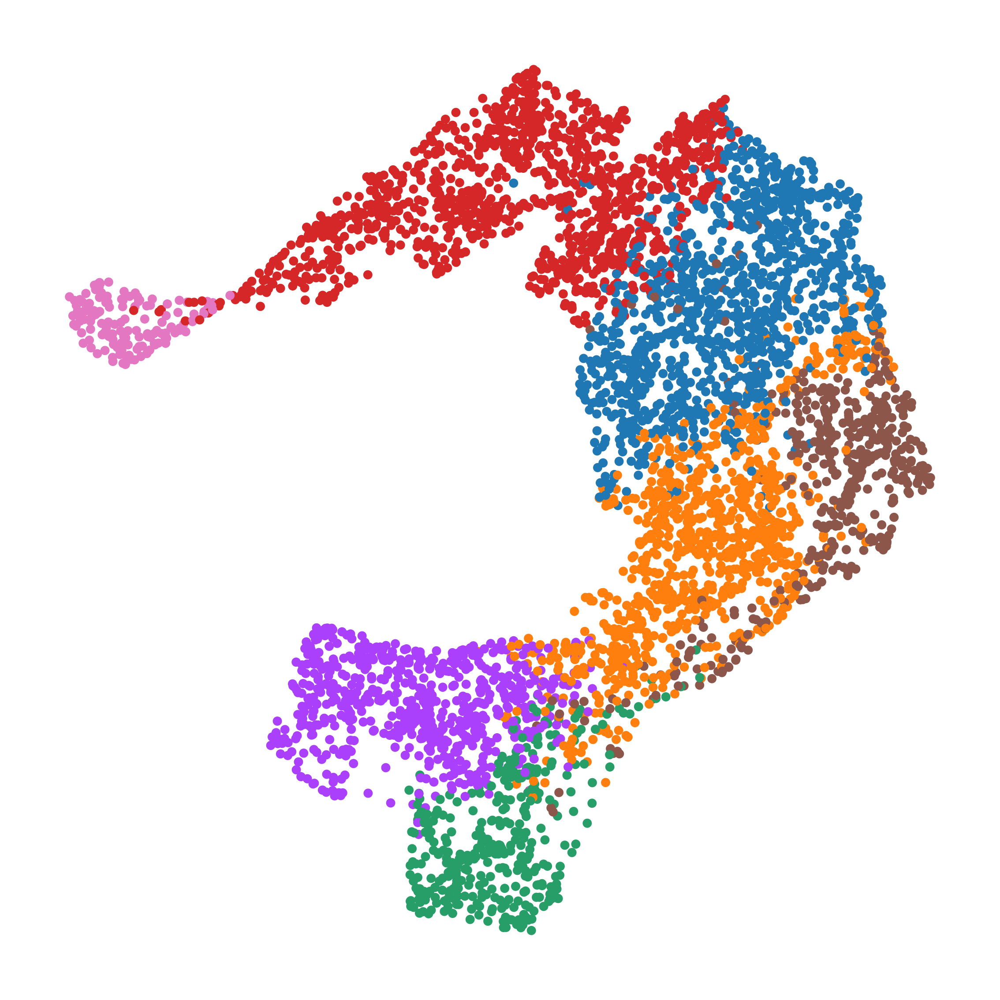

...

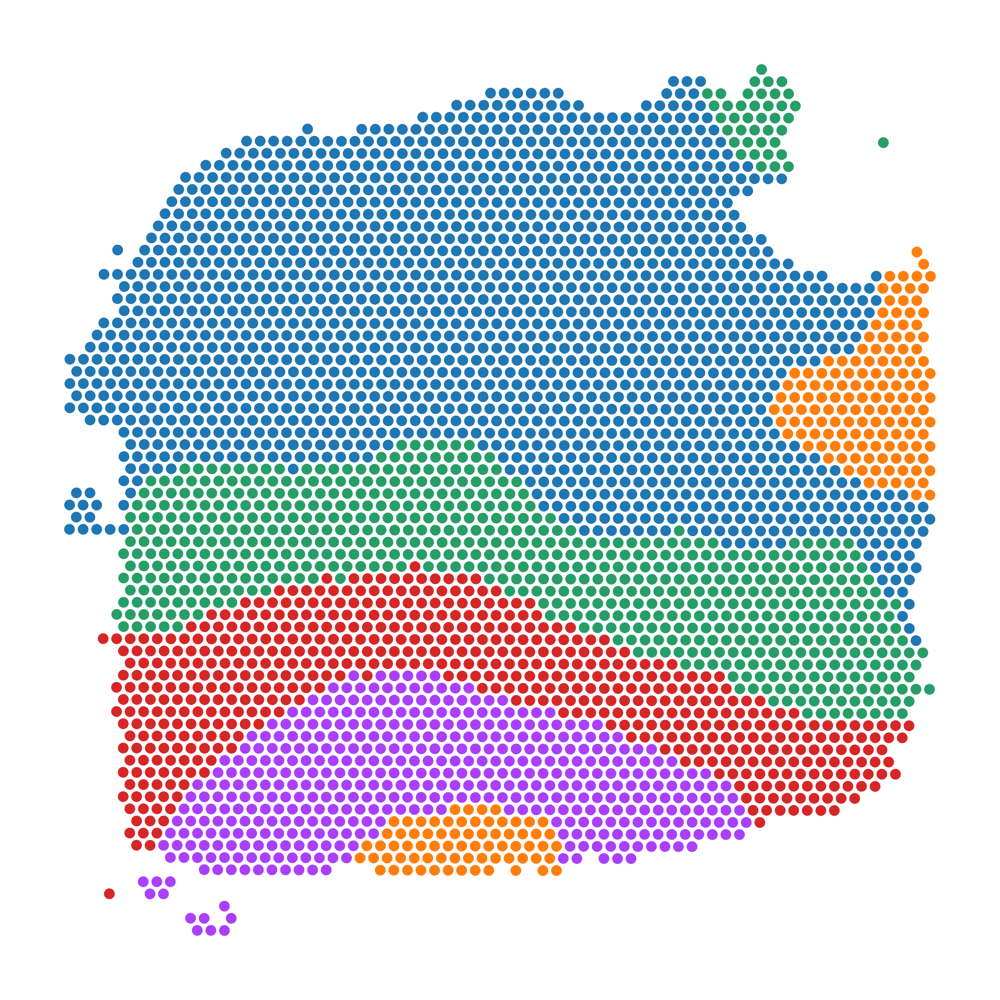

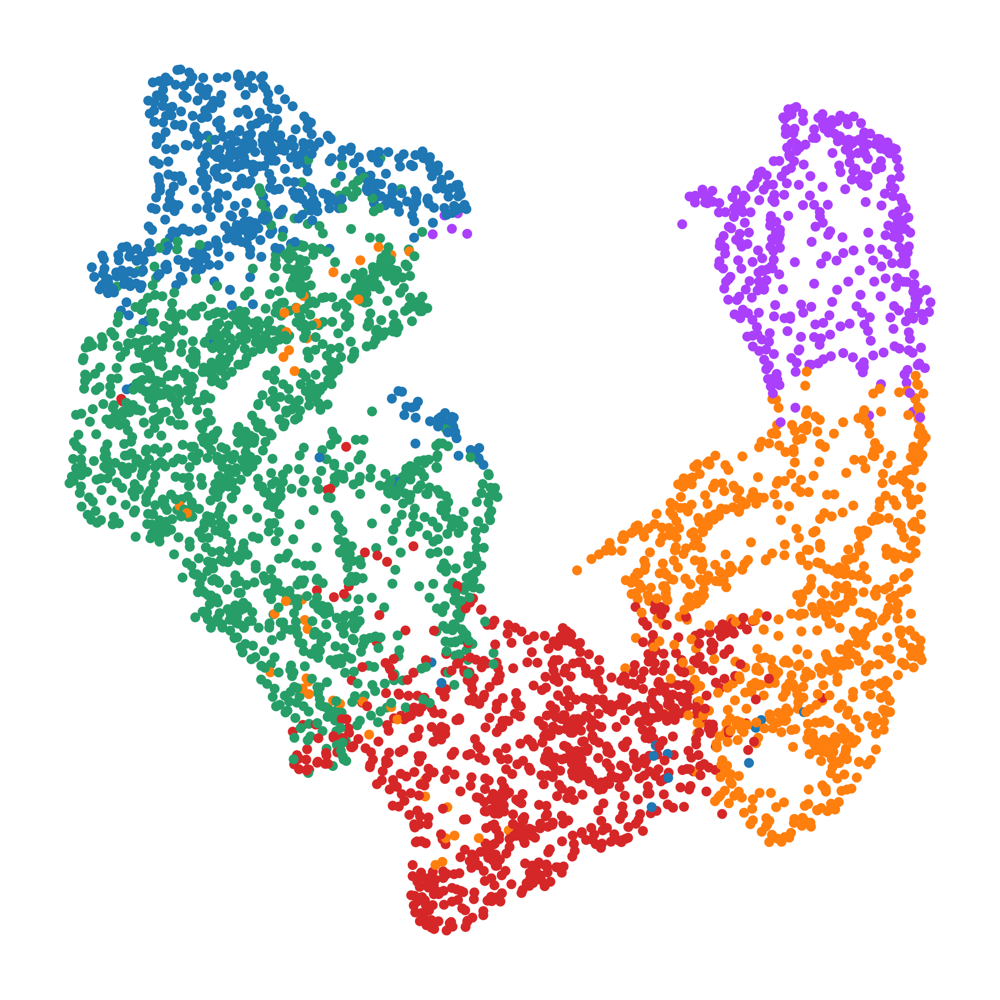

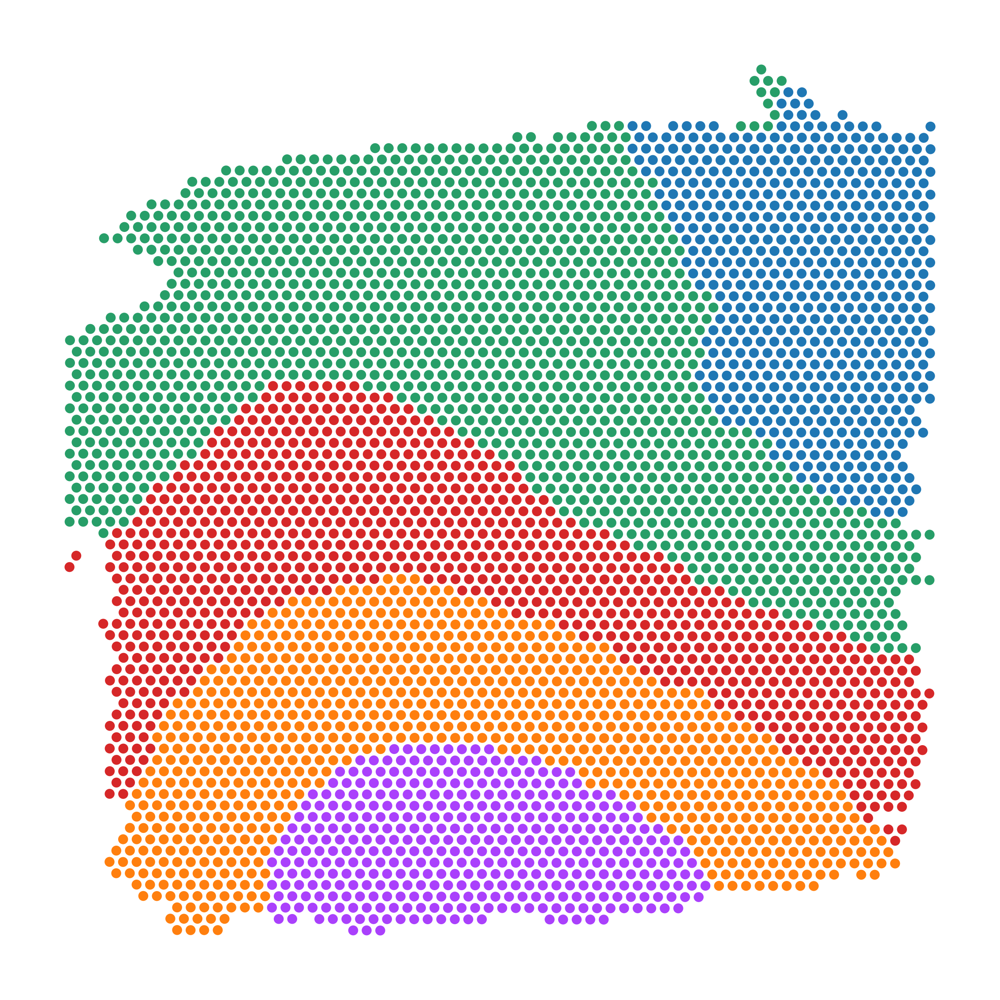

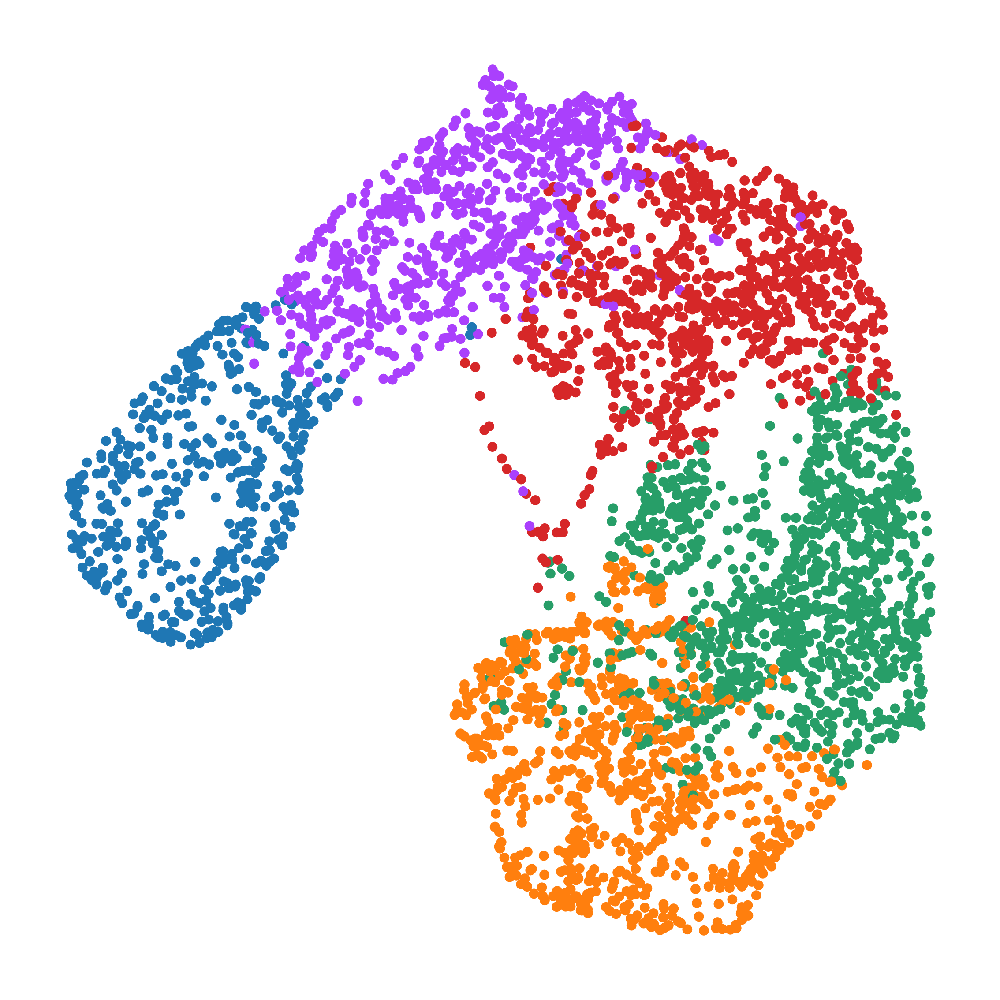

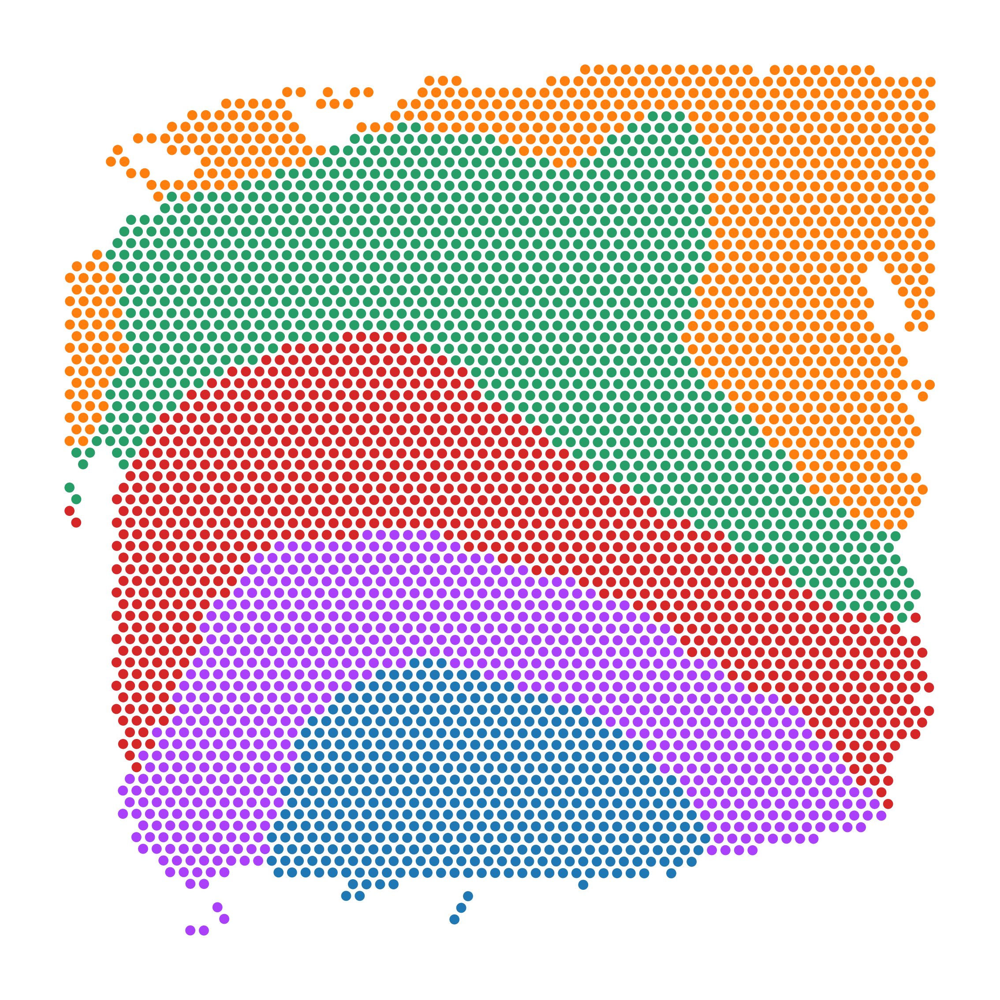

In [11]:
ARI_list = []
NMI_list = []
metrics_list = []
Batch_list = []
adj_list = []
# section_ids = ['151673','151674','151675','151676']
section_ids = [
                 '151507',
                 '151508',
                 '151509',
                 '151510',

                 '151673',
                 '151674',
                 '151675',
                 '151676',

                 '151669',
                 '151670',
                 '151671',
                 '151672',
]
cluster_num = [7, 7, 7, 7, 7, 7, 7, 7, 5, 5, 5, 5]

for i, section_id in enumerate(section_ids):
    print(section_id)
    adata1 = sc.read_h5ad(f'./data/{section_id}.h5ad')
    adata1.obs_names_make_unique()
    adata1.var_names_make_unique()
    data_list = [adata1]
    batch_key = 'batch'
    batch_names = ['adata1']

    adata = process_adata(data_list, batch_key=batch_key, batch_categories=batch_names, n_top_features=3000)
    rad_cutoff_list = [150]
    adata = process_graph(adata, data_list, rad_cutoff_list=rad_cutoff_list)
    path_results = f'./log/integration/'
    adata_stAggregator = stAggregator(adata=adata, max_iteration=800, outdir=path_results, h_dim=16,
                           batch_size=19999, impute=False, early_stop=False, random_seed=42)

    
    # n_clusters=7
    adata_stAggregator = mclust_R_smooth(adata_stAggregator, used_obsm='X_stAggregator', num_cluster=cluster_num[i])
    adata_stAggregator.obs['mclust'] = adata_stAggregator.obs['mclust']
    # stagate
    sc.pp.neighbors(adata_stAggregator, use_rep='X_stAggregator')
    sc.tl.umap(adata_stAggregator)
    clear_fig(sc.pl.umap(adata_stAggregator, color='mclust', title='', legend_loc=None, return_fig=True)).savefig(f'./umap/{section_id}.jpg')
    clear_fig(sc.pl.embedding(adata_stAggregator, color='mclust', title='', legend_loc=None, basis='spatial', return_fig=True)).savefig(f'./spatial/{section_id}.jpg')
    
    adata_new = adata_stAggregator[~adata_stAggregator.obs.loc[:, 'Region'].isnull(), :]
    ari = ari_score(adata_new.obs['Region'], adata_new.obs['mclust'])
    nmi = normalized_mutual_info_score(adata_new.obs['Region'], adata_new.obs['mclust'])
    print('mclust, ARI = %01.3f' % ari)
    print('mclust, NMI = %01.3f' % nmi)
    ARI_list.append(ari)
    NMI_list.append(nmi)
    
    adata_raw = sc.read_h5ad(f'./data/{section_id}.h5ad')
    adata_raw = adata_raw[adata_new.obs.index, :].copy()
    adata_raw.obs.loc[:, 'mclust'] = adata_new.obs.loc[:, 'mclust']
    metrics = evaluate_all(adata_raw, gt_key='Region', pred_key='mclust')
    metrics_list.append(metrics)
    # break

In [15]:
metrics = pd.concat(metrics_list, axis=0)
metrics.index = section_ids
metrics

,ARI,NMI,HOM,COM,CHAOS,ASW,PAS,MoranI,GearyC
151507,0.609441,0.715346,0.698890,0.732595,0.056258,0.037447,0.008055,0.277930,0.722547
151508,0.604541,0.681945,0.650154,0.717005,0.055220,-0.045126,0.015293,0.254640,0.745382
151509,0.401246,0.587998,0.619314,0.559697,0.053506,-0.014463,0.013367,0.260811,0.738626
151510,0.569375,0.637646,0.629040,0.646492,0.055389,-0.121909,0.017845,0.248649,0.751044
151673,0.661095,0.735097,0.737130,0.733074,0.060470,0.011598,0.016893,0.380200,0.616695
151674,0.639300,0.747299,0.752892,0.741788,0.059781,0.025362,0.015131,0.476526,0.523650
151675,0.612398,0.695207,0.707476,0.683355,0.060391,0.045764,0.027762,0.379413,0.617611
151676,0.571870,0.689549,0.675776,0.703895,0.062397,-0.067311,0.016322,0.345798,0.655795
151669,0.459708,0.619650,0.676631,0.571520,0.061191,0.113439,0.007976,0.249420,0.749527
151670,0.560601,0.596981,0.662429,0.543302,0.060310,0.098250,0.006602,0.268630,0.732805


In [12]:
metrics.mean(0)

ARI       0.577515
NMI       0.703261
HOM       0.733680
COM       0.675263
CHAOS     0.059575
ASW       0.120133
PAS       0.009002
MoranI    0.303933
GearyC    0.696840
dtype: float64

In [17]:
metrics.to_csv('metrics_DLPFC_stAggregator.csv', index=True, header=True)

## paga graph

In [24]:
# ARI_list = []
# NMI_list = []
# metrics_list = []
# Batch_list = []
# adj_list = []
# # section_ids = ['151673','151674','151675','151676']
# section_ids = [
#                  '151507',
#                  '151508',
#                  '151509',
#                  '151510',

#                  '151673',
#                  '151674',
#                  '151675',
#                  '151676',

#                  '151669',
#                  '151670',
#                  '151671',
#                  '151672',
# ]
cluster_num = [7, 7, 7, 7, 7, 7, 7, 7, 5, 5, 5, 5]

# for i, section_id in enumerate(section_ids):
i = 3
section_id = 151510
print(section_id)
adata1 = sc.read_h5ad(f'./data/{section_id}.h5ad')
adata1.obs_names_make_unique()
adata1.var_names_make_unique()
data_list = [adata1]
batch_key = 'batch'
batch_names = ['adata1']

adata = process_adata(data_list, batch_key=batch_key, batch_categories=batch_names, n_top_features=3000)
rad_cutoff_list = [150]
adata = process_graph(adata, data_list, rad_cutoff_list=rad_cutoff_list)
path_results = f'./log/integration/'
adata_stAggregator = stAggregator(adata=adata, max_iteration=800, outdir=path_results, h_dim=16,
                       batch_size=19999, impute=False, early_stop=False, random_seed=42)


# n_clusters=7
adata_stAggregator = mclust_R_smooth(adata_stAggregator, used_obsm='X_stAggregator', num_cluster=cluster_num[i])
adata_stAggregator.obs['mclust'] = adata_stAggregator.obs['mclust']
# stagate
sc.pp.neighbors(adata_stAggregator, use_rep='X_stAggregator')
sc.tl.umap(adata_stAggregator)
# clear_fig(sc.pl.umap(adata_stAggregator, color='mclust', title='', legend_loc=None, return_fig=True)).savefig(f'./umap/{section_id}.jpg')
# clear_fig(sc.pl.embedding(adata_stAggregator, color='mclust', title='', legend_loc=None, basis='spatial', return_fig=True)).savefig(f'./spatial/{section_id}.jpg')

# adata_new = adata_stAggregator[~adata_stAggregator.obs.loc[:, 'Region'].isnull(), :]
# ari = ari_score(adata_new.obs['Region'], adata_new.obs['mclust'])
# nmi = normalized_mutual_info_score(adata_new.obs['Region'], adata_new.obs['mclust'])
# print('mclust, ARI = %01.3f' % ari)
# print('mclust, NMI = %01.3f' % nmi)
# ARI_list.append(ari)
# NMI_list.append(nmi)

# adata_raw = sc.read_h5ad(f'./data/{section_id}.h5ad')
# adata_raw = adata_raw[adata_new.obs.index, :].copy()
# adata_raw.obs.loc[:, 'mclust'] = adata_new.obs.loc[:, 'mclust']
# metrics = evaluate_all(adata_raw, gt_key='Region', pred_key='mclust')
# metrics_list.append(metrics)
# break

151510
------Calculating spatial graph...
The graph contains 27198 edges, 4634 cells.
5.8692 neighbors per cell on average.


Epochs: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:22<00:00, 17.77it/s, recon_loss_mse=503.369, sl1_loss=1.336, sl2_loss=1.342, lr: 0.001]
2024-06-25 10:05:18,723 - root - INFO - Output dir: ./log/integration/
2024-06-25 10:05:18,723 - root - INFO - Output dir: ./log/integration/
2024-06-25 10:05:18,723 - root - INFO - Output dir: ./log/integration/


fitting ...
  |======================================================================| 100%


In [25]:
adata_new = adata_stAggregator[~adata_stAggregator.obs.loc[:, 'Region'].isnull(), :]

In [26]:
ari = ari_score(adata_new.obs['Region'], adata_new.obs['mclust'])
nmi = normalized_mutual_info_score(adata_new.obs['Region'], adata_new.obs['mclust'])
print('mclust, ARI = %01.3f' % ari)
print('mclust, NMI = %01.3f' % nmi)

mclust, ARI = 0.569
mclust, NMI = 0.638


In [27]:
sc.tl.paga(adata_new, groups="Region")


... storing 'mclust' as categorical


In [28]:
sc.set_figure_params(dpi=300, figsize=(3, 3), frameon=False)    # TODO 是否画边框

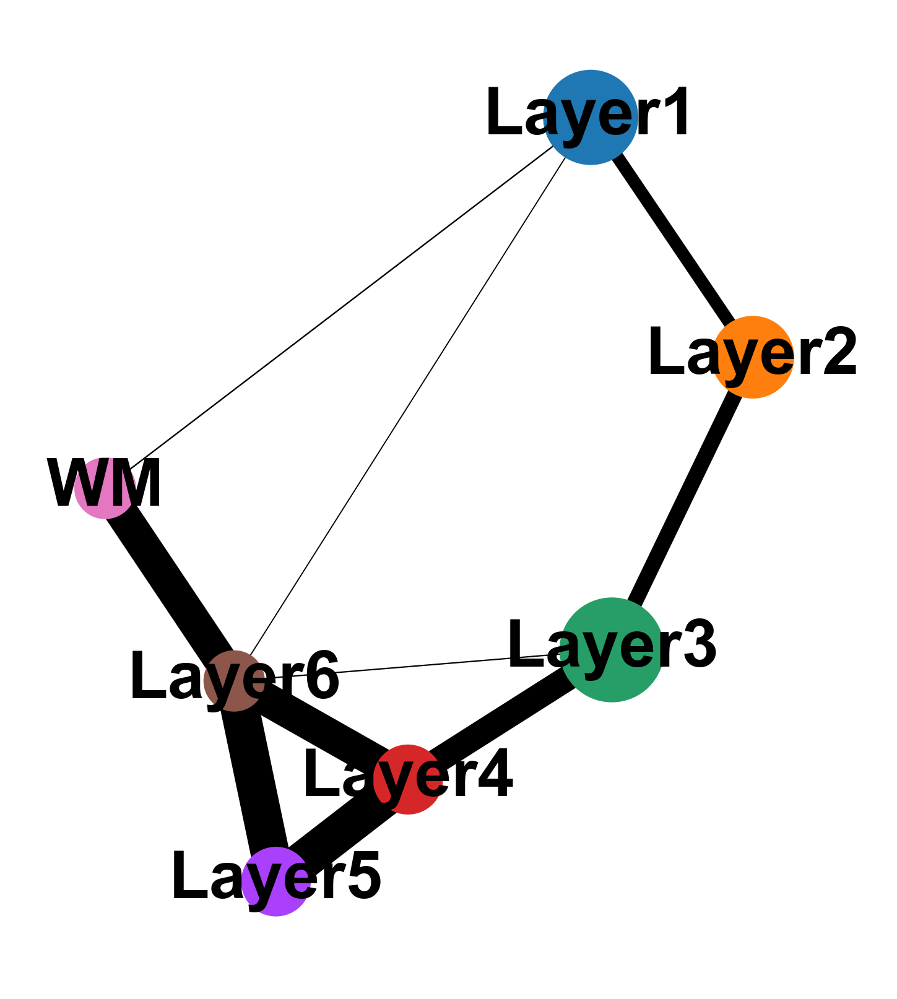

In [29]:
sc.pl.paga(adata_new, color=["Region"])
# display(plt.gcf())
# plt.savefig('example_plot.png')